<a href="https://colab.research.google.com/github/SampadaTandan/harsha/blob/main/Updated_Edge_Aggregation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Tasks
=====
- [x] Filter transactions having less than Rs. 10000.
- [x] Account number replace by integer.
- [x] Sort by time
- [x] Save to better file format (parquet)
- [x] Code to read that parquet file

Later tasks
-----------
- [ ] Split into disjoint graphs



In [ ]:
# Importing libraries
import pandas as pd
import numpy as np
from pathlib import Path
from tqdm import tqdm
import networkx as nx
import pickle
import os
import matplotlib.pyplot as plt

In [ ]:
%cd /content/drive/MyDrive/anais_hackathon
preprocessed_file = Path("Data/Cleaned_data.parquet")
df = pd.read_parquet(preprocessed_file)
print(len(df))
print(df.dtypes)
df = df.drop(df.index[-1])
df


/content/drive/.shortcut-targets-by-id/1HynfHAi4L2APimW-ag8A4kdocd2s12cf/anais_hackathon
2045789
Date/Time          datetime64[ns]
From_Account_id             int32
To_Account_id               int32
amount                    float32
Transaction_id              int32
dtype: object


,Date/Time,From_Account_id,To_Account_id,amount,Transaction_id
0,2024-06-15 00:00:02,1,45023,10000.0,1
1,2024-06-15 00:00:26,2,45024,17000.0,23
2,2024-06-15 00:00:46,3,17,10000.0,39
3,2024-06-15 00:00:47,4,45025,13500.0,42
4,2024-06-15 00:01:09,5,45026,13000.0,62
...,...,...,...,...,...
2045783,2024-12-14 23:58:08,133657,16200,15000.0,63690478
2045784,2024-12-14 23:58:13,580016,337627,16750.0,63690481
2045785,2024-12-14 23:58:21,53155,392292,20000.0,63690488
2045786,2024-12-14 23:58:55,3911,166098,14200.0,63690511


In [ ]:
graph_file_path = os.path.join('/content/drive/MyDrive/', 'data.pkl')
with open(graph_file_path, 'rb') as f:
    G = pickle.load(f)


In [ ]:
ndf = df.drop(columns=["Date/Time"])


agf = ndf.groupby(["From_Account_id", "To_Account_id"]).agg(
    total_amount=("amount", "sum"),
    transaction_count=("amount", "count")
).reset_index()

In [ ]:
agf = agf[agf["total_amount"] > 10000]
agf

,From_Account_id,To_Account_id,total_amount,transaction_count
0,1,13241,11000.0,1
2,2,131,11000.0,1
3,2,13302,12550.0,1
4,2,30104,24000.0,1
5,2,30387,29000.0,2
...,...,...,...,...
1256558,737454,742564,15500.0,1
1256559,737455,679917,25000.0,1
1256560,737456,742570,20000.0,2
1256561,737457,742573,50000.0,2


In [ ]:
df[df.amount == df['amount'].max()]

,Date/Time,From_Account_id,To_Account_id,amount,Transaction_id
966110,2024-09-18 17:23:13,12216,52700,11394027.0,32543699


In [ ]:
agf[agf['From_Account_id']==12216]

,From_Account_id,To_Account_id,total_amount,transaction_count
110785,12216,52700,5.475522e+07,6
110786,12216,502703,2.891356e+06,1
110787,12216,502730,8.032300e+05,1
110788,12216,502731,2.164139e+04,1
110789,12216,502733,3.742350e+04,1


In [ ]:
agf[agf['From_Account_id']==12216]

In [ ]:
def createGraph(df):
  G = nx.MultiDiGraph()

  # Add edges with weights
  count = 0
  for _, row in df.iterrows():
      count += 1
      if count % 10000 == 0:
          print(count)
      G.add_edge(row['From_Account_id'], row['To_Account_id'], weight=row['amount'])
  return G



In [ ]:
# def showGraph(G):
#   pos = nx.spring_layout(G)  # Layout for positioning nodes
#   weights = nx.get_edge_attributes(G, 'weight')  # Get edge weights

#   plt.figure(figsize=(8, 6))
#   nx.draw(
#       G, pos, with_labels=True, node_size=500, node_color='lightblue',
#       font_size=10, font_weight='bold', arrowsize=15
#   )
#   nx.draw_networkx_edge_labels(G, pos, edge_labels=weights)
#   plt.title("Transaction Network Graph")
#   plt.show()

#onlyGraph
# def showGraph(G,figSize=(12,8)):
#   pos = nx.spring_layout(G)  # Layout for positioning nodes

#   plt.figure(figsize=figSize)
#   nx.draw(
#       G, pos, with_labels=False,  # Set with_labels to False to hide node values
#       node_size=10, node_color='lightblue',
#       font_size=10, font_weight='bold', arrowsize=10
#   )
#   plt.title("Transaction Network Graph")
#   plt.show()

def showGraph(G, target_node, figSize=(12, 8),filename='image.png'):
  """
  Displays a graph with a highlighted target node.

  Args:
    G: The NetworkX graph to display.
    target_node: The node to highlight.
    figSize: The figure size (optional, defaults to (12, 8)).
  """
  pos = nx.spring_layout(G)  # Layout for positioning nodes

  plt.figure(figsize=figSize)

  # Draw all nodes except the target node
  nx.draw(
      G,
      pos,
      with_labels=False,
      node_size=10,
      node_color='lightblue',
      font_size=10,
      font_weight='bold',
      arrowsize=10,
  )

  # Highlight the target node
  nx.draw_networkx_nodes(
      G,
      pos,
      nodelist=[target_node],  # Specify the target node
      node_size=100,  # Increase size for visibility
      node_color='red',  # Set a different color
      label=str(target_node),  # Add a label
  )

  # Display the label
  nx.draw_networkx_labels(
      G,
      pos,
      labels={target_node: str(target_node)},  # Label only the target node
      font_size=12,
      font_color='black',
  )

  plt.title("Transaction Network Graph")
  plt.savefig(filename)
  # plt.show()

In [ ]:
def saveGraph(G,graph_file_path):
  %cd /content/drive
  with open(graph_file_path, "wb") as file:
      pickle.dump(G, file)

  print("Graph saved successfully!")

In [ ]:
def show_connected_graph(G, account_id):
    # Get all nodes connected to the given account
    if account_id in G:
        bfs_edges = nx.bfs_edges(G, source=account_id, depth_limit=1)
        connected_nodes = {account_id}  # Include the source node
        for edge in bfs_edges:
            connected_nodes.update(edge)
        # connected_nodes = set(nx.node_connected_component(G.to_undirected(), account_id))
        # return connected_nodes
        subgraph = G.subgraph(connected_nodes)

        showGraph(subgraph)
    else:
        print(f"Account {account_id} not found in the graph.")





In [ ]:
rg= G.reverse()

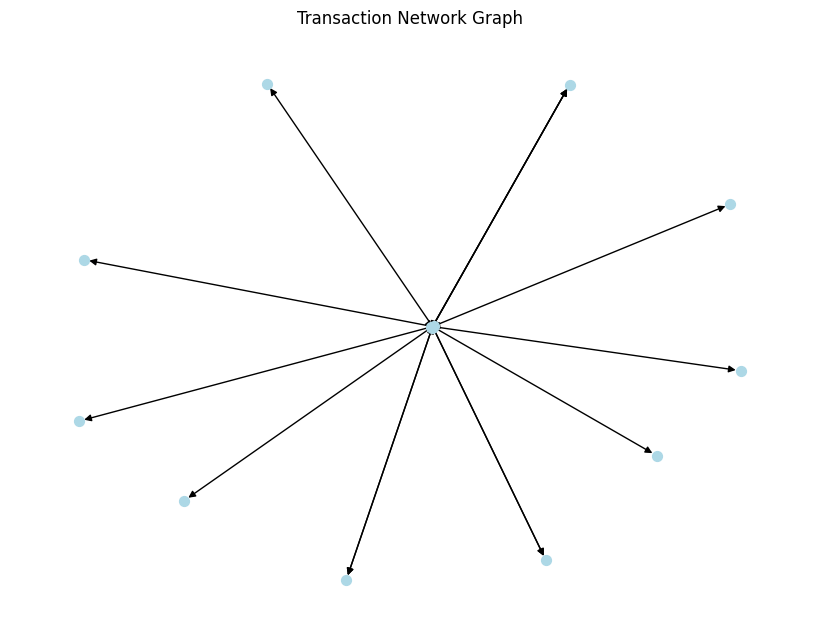

In [ ]:
cnodes = show_connected_graph(G, 9125)

In [ ]:
df.head()

NameError: name 'df' is not defined

In [ ]:
df.head()

,Date/Time,From_Account_id,To_Account_id,amount,Transaction_id
0,2024-06-15 00:00:02,1,45023,10000.0,1
1,2024-06-15 00:00:26,2,45024,17000.0,23
2,2024-06-15 00:00:46,3,17,10000.0,39
3,2024-06-15 00:00:47,4,45025,13500.0,42
4,2024-06-15 00:01:09,5,45026,13000.0,62


In [ ]:
agf = df.drop(columns=["Date/Time"])


agf = agf.groupby(["To_Account_id"]).agg(
    total_amount=("amount", "sum"),
    transaction_count=("amount", "count")
).reset_index()

In [ ]:
agf = agf.sort_values(by='total_amount', ascending=False)
agf

,To_Account_id,total_amount,transaction_count
11739,15208,217401904.0,8768
41422,52700,54755216.0,6
757,944,30943250.0,1905
366209,484417,27916652.0,1166
7154,9222,18784384.0,1125
...,...,...,...
152033,189231,10000.0,1
194213,244394,10000.0,1
418677,566427,10000.0,1
418676,566426,10000.0,1


In [ ]:
sus_accounts = agf[agf['total_amount']>10000000]['To_Account_id']

In [ ]:
sus_accounts

,To_Account_id
11739,15208
41422,52700
757,944
366209,484417
7154,9222
16385,21316
31027,41272
2827,3653
97903,118728
6932,8923


In [ ]:
agf.head(20)

,To_Account_id,total_amount,transaction_count
11739,15208,217401904.0,8768
41422,52700,54755216.0,6
757,944,30943250.0,1905
366209,484417,27916652.0,1166
7154,9222,18784384.0,1125
16385,21316,18678196.0,1032
31027,41272,17719556.0,744
2827,3653,16820504.0,871
97903,118728,12935524.0,533
6932,8923,12086610.0,521


In [ ]:
sus_accounts.count()

11

In [ ]:
incoming = df.groupby("To_Account_id").agg(
    totalincomingamount=("amount", "sum"),
    incomingtransactions=("amount", "count"),
    noofadjacentincomingnodes=("From_Account_id", "nunique"),
).rename_axis("account_no").reset_index()

# Aggregate outgoing transactions
outgoing = df.groupby("From_Account_id").agg(
    totaloutgoingamount=("amount", "sum"),
    outgoingtransactions=("amount", "count"),
    noofadjacentoutgoingnodes=("To_Account_id", "nunique"),
).rename_axis("account_no").reset_index()

# Combine incoming and outgoing data
result = pd.merge(incoming, outgoing, on="account_no", how="outer").fillna(0)
result['netamount'] = result['totalincomingamount'] - result['totaloutgoingamount']

result = result.sort_values(by='incomingtransactions', ascending=False)


In [ ]:
result.head(20)

,account_no,totalincomingamount,incomingtransactions,noofadjacentincomingnodes,totaloutgoingamount,outgoingtransactions,noofadjacentoutgoingnodes,netamount
15207,15208,217401904.0,8768.0,11.0,3210907.0,159.0,1.0,214190992.0
943,944,30943250.0,1905.0,67.0,22290740.0,1147.0,166.0,8652510.0
484416,484417,27916652.0,1166.0,28.0,563430.0,25.0,8.0,27353222.0
9221,9222,18784384.0,1125.0,91.0,13331354.0,674.0,144.0,5453030.0
21315,21316,18678196.0,1032.0,33.0,6401000.0,383.0,48.0,12277196.0
3652,3653,16820504.0,871.0,232.0,20929248.0,1149.0,407.0,-4108744.0
41271,41272,17719556.0,744.0,20.0,335624.0,22.0,7.0,17383932.0
34064,34065,11782676.0,712.0,275.0,3401892.0,185.0,120.0,8380784.0
118727,118728,12935524.0,533.0,9.0,37000.0,2.0,2.0,12898524.0
8922,8923,12086610.0,521.0,61.0,4800463.0,275.0,132.0,7286147.0


In [ ]:
result.describe()

,account_no,totalincomingamount,incomingtransactions,noofadjacentincomingnodes,totaloutgoingamount,outgoingtransactions,noofadjacentoutgoingnodes,netamount
count,742575.000000,7.425750e+05,742575.000000,742575.000000,7.425750e+05,742575.000000,742575.000000,7.425750e+05
mean,371288.000000,4.323194e+04,2.754993,1.692171,4.323194e+04,2.754993,1.692171,-2.585597e-04
std,214363.082408,2.953544e+05,13.099995,3.432318,4.309755e+05,18.666244,4.076696,4.971918e+05
min,1.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000,-3.441514e+08
25%,185644.500000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000,-1.780000e+04
50%,371288.000000,1.400000e+04,1.000000,1.000000,1.300000e+04,1.000000,1.000000,0.000000e+00
75%,556931.500000,3.500000e+04,2.000000,2.000000,3.500000e+04,2.000000,2.000000,1.810000e+04
max,742575.000000,2.174019e+08,8768.000000,322.000000,3.476618e+08,14492.000000,575.000000,2.141910e+08


In [ ]:
result['incomingtransactions'].drop


,incomingtransactions
15207,8768.0
943,1905.0
484416,1166.0
9221,1125.0
21315,1032.0


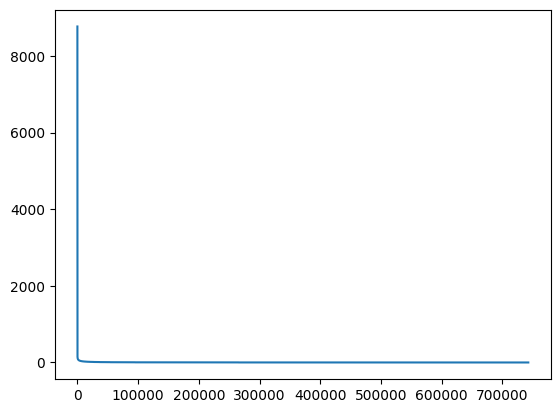

In [ ]:
plt.plot(result['incomingtransactions'].reset_index(drop=True))

In [ ]:
result[(result['incomingtransactions']>5) | (result['outgoingtransactions']>5)]

,account_no,totalincomingamount,incomingtransactions,noofadjacentincomingnodes,totaloutgoingamount,outgoingtransactions,noofadjacentoutgoingnodes,netamount
15207,15208,217401904.0,8768.0,11.0,3210907.0,159.0,1.0,214190992.0
943,944,30943250.0,1905.0,67.0,22290740.0,1147.0,166.0,8652510.0
484416,484417,27916652.0,1166.0,28.0,563430.0,25.0,8.0,27353222.0
9221,9222,18784384.0,1125.0,91.0,13331354.0,674.0,144.0,5453030.0
21315,21316,18678196.0,1032.0,33.0,6401000.0,383.0,48.0,12277196.0
...,...,...,...,...,...,...,...,...
267259,267260,0.0,0.0,0.0,85000.0,7.0,1.0,-85000.0
267193,267194,0.0,0.0,0.0,828100.0,53.0,1.0,-828100.0
267157,267158,0.0,0.0,0.0,111600.0,7.0,3.0,-111600.0
267143,267144,0.0,0.0,0.0,154500.0,10.0,2.0,-154500.0


In [ ]:
result

,account_no,totalincomingamount,incomingtransactions,noofadjacentincomingnodes,totaloutgoingamount,outgoingtransactions,noofadjacentoutgoingnodes,netamount
15207,15208,217401904.0,8768.0,11.0,3210907.0,159.0,1.0,214190992.0
943,944,30943250.0,1905.0,67.0,22290740.0,1147.0,166.0,8652510.0
484416,484417,27916652.0,1166.0,28.0,563430.0,25.0,8.0,27353222.0
9221,9222,18784384.0,1125.0,91.0,13331354.0,674.0,144.0,5453030.0
21315,21316,18678196.0,1032.0,33.0,6401000.0,383.0,48.0,12277196.0
...,...,...,...,...,...,...,...,...
267143,267144,0.0,0.0,0.0,154500.0,10.0,2.0,-154500.0
267140,267141,0.0,0.0,0.0,13000.0,1.0,1.0,-13000.0
267139,267140,0.0,0.0,0.0,12000.0,1.0,1.0,-12000.0
267133,267134,0.0,0.0,0.0,70900.0,6.0,2.0,-70900.0


In [ ]:
def plot_account_balance_over_time(df, account_id):
    """
    Plots the amount stored in an account over time.

    Parameters:
        df (pd.DataFrame): The input DataFrame with transaction data.
                           It should have columns 'Date/Time', 'From_Account_id', 'To_Account_id', and 'amount'.
        account_id (int): The ID of the account to plot.
    """
    # Ensure 'Date/Time' is in datetime format
    df['Date/Time'] = pd.to_datetime(df['Date/Time'])

    # Sort transactions by date
    df = df.sort_values(by='Date/Time')

    # Create a new column to track balance changes
    df['balance_change'] = 0
    df.loc[df['From_Account_id'] == account_id, 'balance_change'] -= df['amount']
    df.loc[df['To_Account_id'] == account_id, 'balance_change'] += df['amount']

    # Calculate cumulative balance over time
    balance_over_time = df.groupby('Date/Time')['balance_change'].sum().cumsum()

    # Plot the balance over time
    plt.figure(figsize=(10, 6))
    plt.plot(balance_over_time.index, balance_over_time.values, marker='o', label=f'Account {account_id}')
    plt.title(f"Balance Over Time for Account {account_id}")
    plt.xlabel("Date/Time")
    plt.ylabel("Balance")
    plt.grid(True)
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

plot_account_balance_over_time(df, 944)

In [ ]:
SINGLE_TRANSACTION_THRES = 10000

In [ ]:
susaccount = sus_accounts.iloc[0]

In [ ]:
sus_trans = dict()
sus_trans[susaccount] = []

for idx, row in df.iterrows():
  if row['To_Account_id'] == susaccount:
    amount = row['amount']
    if amount > SINGLE_TRANSACTION_THRES:
      sus_trans[susaccount].append(row)
    break

11034

Date/Time          2024-06-16 11:20:16
From_Account_id                   9122
To_Account_id                    15208
amount                         25000.0
Transaction_id                  389653
Name: 11034, dtype: object
25000.0


In [ ]:
df.head()

,Date/Time,From_Account_id,To_Account_id,amount,Transaction_id
0,2024-06-15 00:00:02,1,45023,10000.0,1
1,2024-06-15 00:00:26,2,45024,17000.0,23
2,2024-06-15 00:00:46,3,17,10000.0,39
3,2024-06-15 00:00:47,4,45025,13500.0,42
4,2024-06-15 00:01:09,5,45026,13000.0,62


In [ ]:
SINGLE_TRANSACTION_THRES = 15000.0
MAX_DEPTH = 3

# Function to backtrack suspicious accounts
def backtrack_sus_transactions(df, susaccount, depth=0, max_depth=MAX_DEPTH, visited=None, sus_trans=None):
    if visited is None:
        visited = set()
    if sus_trans is None:
        sus_trans = dict()

    # Base case: stop if max depth is reached or account is already visited
    if depth > max_depth or susaccount in visited:
        return

    # Mark account as visited
    visited.add(susaccount)

    # Initialize the account in sus_trans if not already
    if susaccount not in sus_trans:
        sus_trans[susaccount] = []

    # Filter transactions where the account is the recipient
    transactions = df[df['To_Account_id'] == susaccount]

    for _, row in transactions.iterrows():
        amount = row['amount']

        # Check transaction properties
        if amount > SINGLE_TRANSACTION_THRES:
            sus_trans[susaccount].append(row.to_dict())

            # Recursively backtrack the sender account
            sender_account = row['From_Account_id']
            backtrack_sus_transactions(df, sender_account, depth + 1, max_depth, visited, sus_trans)

    return sus_trans

# suspicious_transactions = backtrack_sus_transactions(df, susaccount)
# print(suspicious_transactions)

{15208: [{'Date/Time': Timestamp('2024-06-16 11:20:16'), 'From_Account_id': 9122, 'To_Account_id': 15208, 'amount': 25000.0, 'Transaction_id': 389653}, {'Date/Time': Timestamp('2024-06-16 11:20:20'), 'From_Account_id': 9122, 'To_Account_id': 15208, 'amount': 25000.0, 'Transaction_id': 389680}, {'Date/Time': Timestamp('2024-06-16 11:20:21'), 'From_Account_id': 9122, 'To_Account_id': 15208, 'amount': 25000.0, 'Transaction_id': 389686}, {'Date/Time': Timestamp('2024-06-16 11:20:25'), 'From_Account_id': 9122, 'To_Account_id': 15208, 'amount': 25000.0, 'Transaction_id': 389705}, {'Date/Time': Timestamp('2024-06-16 11:31:33'), 'From_Account_id': 9122, 'To_Account_id': 15208, 'amount': 25000.0, 'Transaction_id': 393645}, {'Date/Time': Timestamp('2024-06-16 11:31:38'), 'From_Account_id': 9122, 'To_Account_id': 15208, 'amount': 25000.0, 'Transaction_id': 393682}, {'Date/Time': Timestamp('2024-06-16 11:31:43'), 'From_Account_id': 9122, 'To_Account_id': 15208, 'amount': 25000.0, 'Transaction_id':

/content/drive/MyDrive/susgraphs


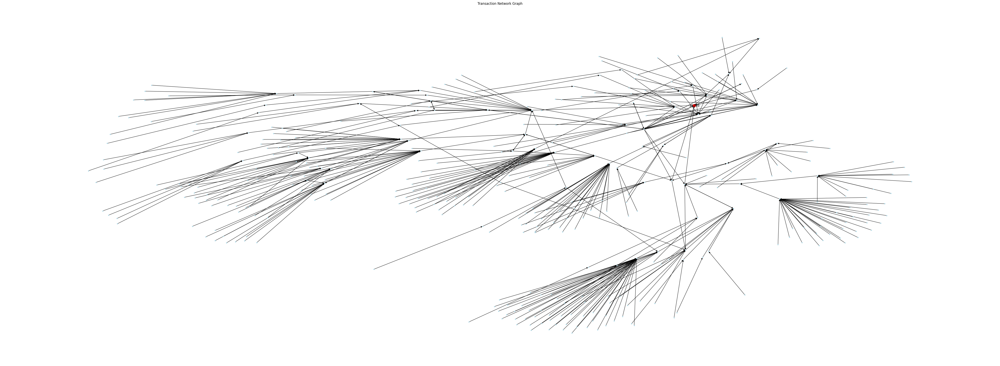

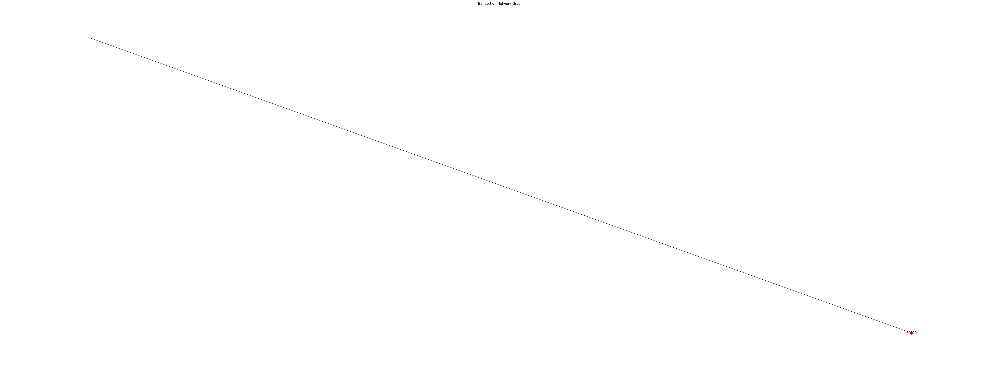

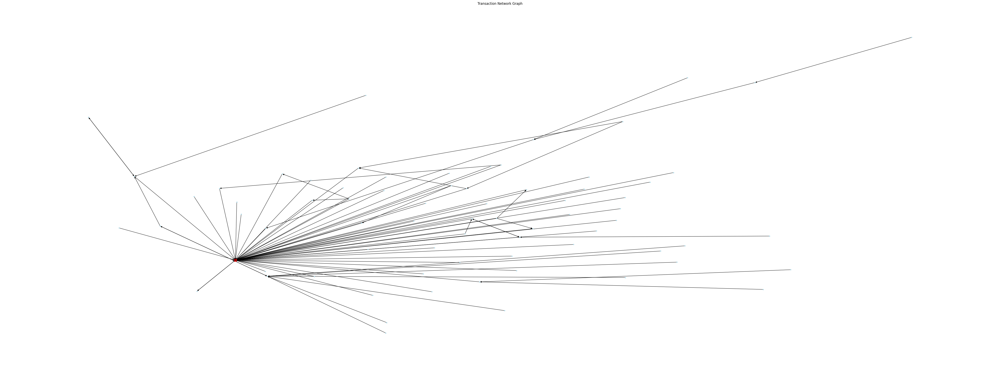

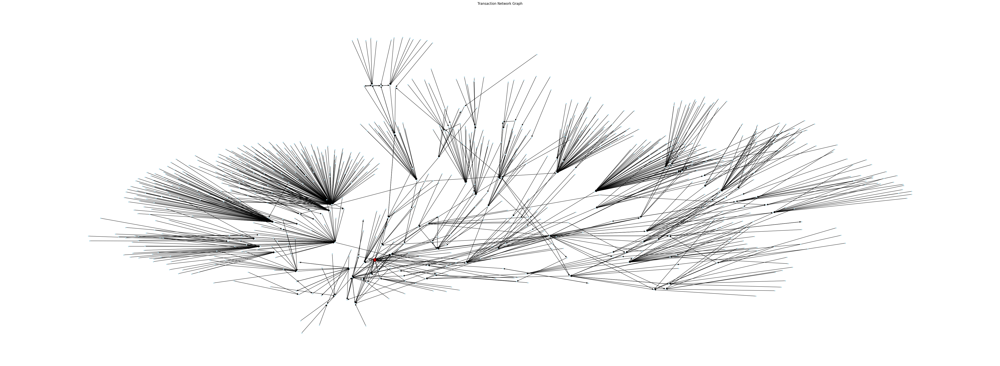

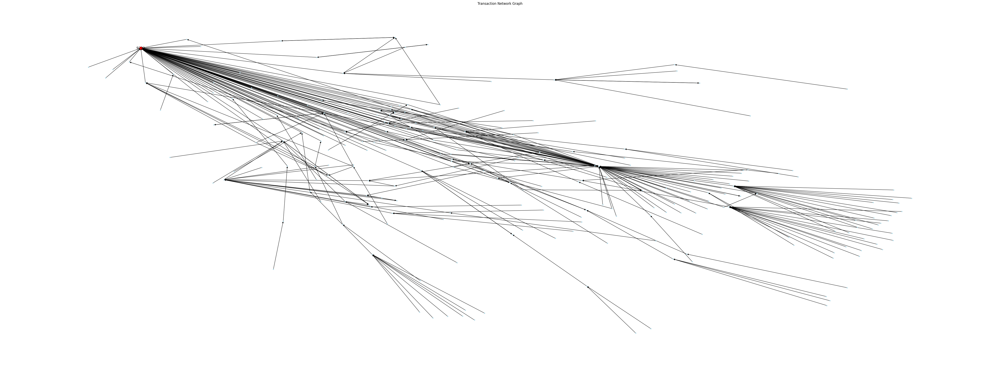

...

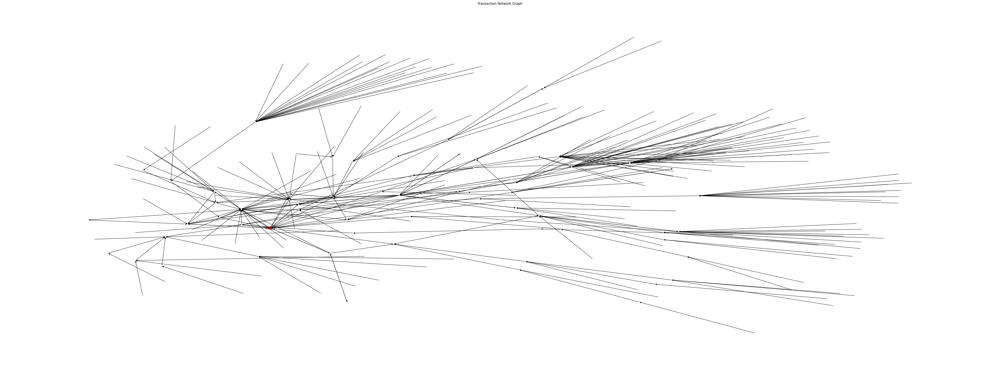

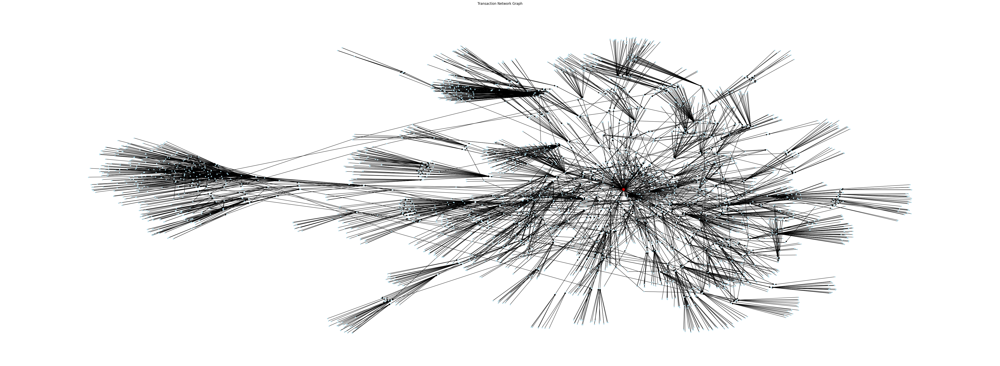

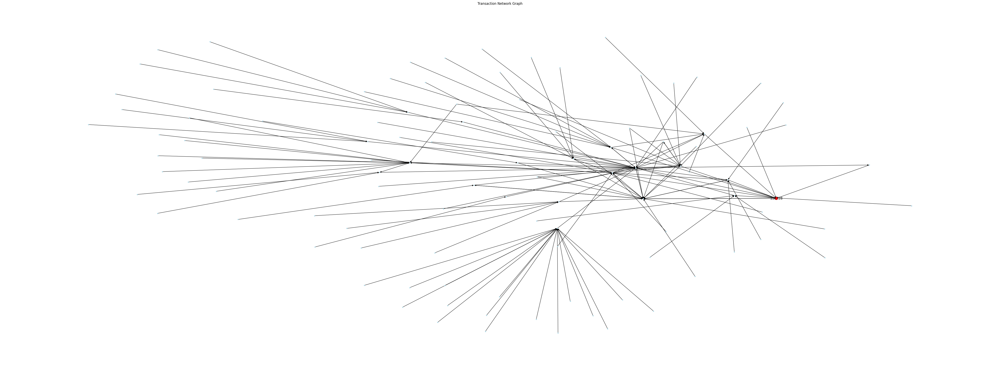

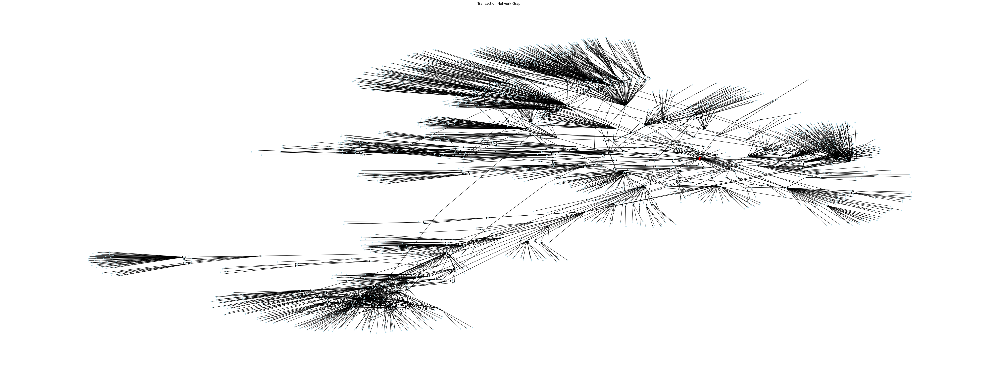

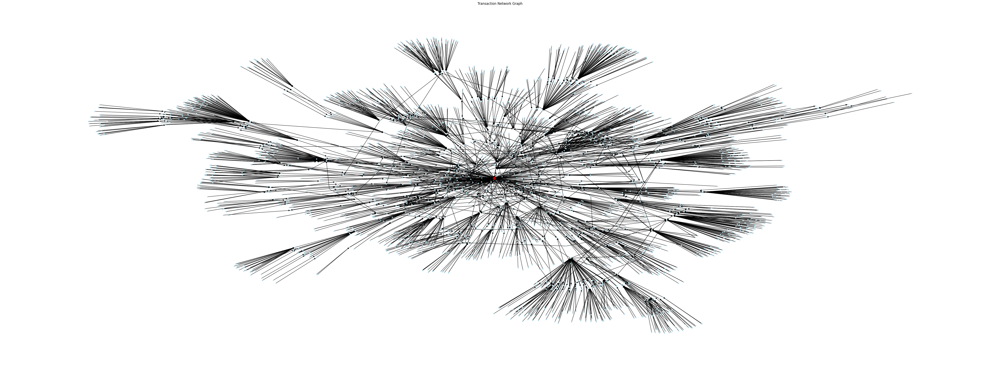

In [ ]:
%cd /content/drive/MyDrive/susgraphs/
def display_suspicious_transactions_graph(suspicious_transactions,susaccount):
    # Create a directed graph
    G = nx.DiGraph()

    # Add edges based on suspicious transactions
    for account, transactions in suspicious_transactions.items():
        for transaction in transactions:
            G.add_edge(
                transaction["From_Account_id"],
                transaction["To_Account_id"],
                amount=transaction["amount"],
                transaction_id=transaction["Transaction_id"],
            )
    showGraph(G,susaccount, (50,18),f"root_{susaccount}.png")

# Example usage: Display the graph for suspicious transactions
for susaccount in sus_accounts:
  suspicious_transactions = backtrack_sus_transactions(df, susaccount)
  display_suspicious_transactions_graph(suspicious_transactions,susaccount)